In [1]:
from mpl_toolkits import mplot3d
#%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import math
import time

In [2]:
#this part is function implementations
#1)	High Conditional Elliptic Function
def f_HCEF(X_set,D):
    Z=0
    for i in range(D):
        Z+=(10**6)**((i)/(D-1))*X_set[i]**2
    return Z

#2)	Bent Cigar Function
def f_BC(X_set,D):
    Z=X_set[0]**2
    for i in range(1,D):
        Z+= 10**6*X_set[i]**2
    return Z

#3)	Discus Function
def f_Discus(X_set,D):
    Z=(10**6)*(X_set[0]**2)
    for i in range(1,D):
        Z+=X_set[i]**2
    return Z

#4)	Rosenbrock’s Function
def f_Rosenbrock(X_set,D):
    Z=0
    for i in range(D-1):
        Z+=(100*(X_set[i]**2-X_set[i+1])**2+(X_set[i]-1)**2)
    return Z

#5)	Ackley’s Function
def f_Ackley(X_set,D):
    V1=0
    for i in range(D):
        V1+=X_set[i]**2
    V2=0
    for i in range(D):
        V2+=np.cos(2*math.pi*X_set[i])
    return -1*20*np.exp(-1*0.2*np.sqrt((1/D)*V1)) - np.exp((1/D)*V2)+20+math.e

#6)	Weierstrass Function
def f_Weierstrass(X_set,D):
    Kmax=20
    a=0.5
    b=3
    
    V1=0
    for i in range(D):
        for k in range(Kmax+1):
            V1+=a**k*np.cos(2*math.pi*b**k*(X_set[i]+0.5))
    V2=0
    for k in range(Kmax+1):
        V2+=a**k*np.cos(2*math.pi*b**k*0.5)
    return V1-D*V2

#7)	Griewank’s Function
def f_Griewank(X_set,D):
    V1=0
    for i in range(D):
        V1+=(X_set[i]**2)/(4000)
    V2=1
    for i in range(D):
        V2*=np.cos(X_set[i]/np.sqrt(i+1))
    return V1-V2+1

#8)	Rastrigin’s Function
def f_Rastrigin(X_set,D):
    Z=0
    for i in range(D):
        Z+=X_set[i]**2 - 10*np.cos(2*math.pi*X_set[i]) + 10
    return Z

In [3]:
#this part is to plot the 2 dimensional plots of the functions
def plot_func(func):
    #generate 100 number within the range [-10,10]
    x = np.linspace(-10, 10, 100)
    y = np.linspace(-10, 10, 100)

    #create two planes
    X, Y = np.meshgrid(x, y)

    #generate Z values for each x,y pairs within the planes for each functions
    Z = func([X,Y],2)

    #plot
    fig = plt.figure()
    ax = plt.axes(projection='3d')
    ax.contour3D(X, Y, Z, 100, cmap='viridis')
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_zlabel('z');
    plt.show()
#plot_func(f_Rastrigin)

In [4]:
import random
from numpy.random import choice
from copy import deepcopy
# import numpy as np
# import matplotlib.pyplot as plt
 

#THE PARTICLE SwARM OPTIMIZER===============
#==========================================================================================
#==========================================================================================
    
# the initialization function to generate initial random populations and the initial velocities
def initialization(NP, D, v_max, v_min):
    population=[]
    V=[]
    for i in range(NP):
        population.append([])
        V.append([])
        for j in range(D):
            #population[i].append(random.randint(-10,10))
            population[i].append(random.uniform(-10,10))
            V[i].append(random.uniform(v_min,v_max))
    #V = np.random.randn(NP, D)*0.1
    #print("initial population :",population)
    return population, V
 
#calculate fitness value for bounded trial vectors(input:2D list)
def calcFitness(population,func,D):
    score = []
    
    for i in range(len(population)):
        #print("fitness:",func(population[i]))
        if func == "HCEF":
            score.append(f_HCEF(population[i],D))
        elif func == "BC":
            score.append(f_BC(population[i],D))
        elif func == "Discus":
            score.append(f_Discus(population[i],D))
        elif func == "Rosenbrock":
            score.append(f_Rosenbrock(population[i],D))
        elif func == "Ackley":
            score.append(f_Ackley(population[i],D))
        elif func == "Weierstrass":
            score.append(f_Weierstrass(population[i],D))
        elif func =="Griewank":
            score.append(f_Griewank(population[i],D))
        elif func =="Rastrigin":
            score.append(f_Rastrigin(population[i],D))
    return score
# Update velocities
def velocity(population,V,gbest,pbest,C1,C2,W):
    p1=np.random.rand()
    p2=np.random.rand()
    
    for i in range(len(population)):
        for j in range(len(population[i])):
            V[i][j]=W*V[i][j] + C1*p1*(pbest[i][j]-population[i][j]) + C2*p2*(gbest[j]-population[i][j])
    return V
#update position
def positionUpdate(population,V):
    for i in range(len(population)):
        for j in range(len(population[i])):
            population[i][j]=population[i][j]+V[i][j]
            if(population[i][j]>10):
                population[i][j]=10
            elif(population[i][j]<-10):
                population[i][j]=-10
    return deepcopy(population)
# Adjust bounds of offspring
def bound(x):
    for i in range(len(x)):
        if x[i] <= 10 and x[i] >= -10:
            pass
        elif x[i] > 10:
            x[i]= 10
        elif x[i] < -10:
            x[i]= -10
    return x

# In[2]:
#######main process Here#############
def sovler(func_name, dimension):
    # NP=100 number of population
    # D=5    dimension
    # MAXFES= 5000*D the maximum number of generations
    
    D=dimension #dimension
    NP=100
    v_max=0.1*(10-(-10))
    v_min=-v_max

    MAXFES= int(D*3000/NP) #25000
    population = []
    population,V = initialization(NP,D,v_max,v_min)

    solution=[]
    
    C1 = 2.05
    C2 = 2.05
    W=0.9
    
    currentLowstRecord=[] # this is to record the lowest (best) score for every generation
    populationRecord=[] # record population of every generation
    
    #the fitness score for initial population
    current_score = calcFitness(population,func_name,D) #[45000049, 10000004, 110000009, 115000016, 115000049]
    
    #find first global best individual(currentBest is the current best score)
    currentBest,idx=min((currentBest, idx) for (idx, currentBest) in enumerate(current_score))
    gbest = deepcopy(population[idx])
    gbest_score=currentBest
    
    #assign the first local best individual
    pbest = deepcopy(population[:])# the initial ones are themselves
    pbest_score = deepcopy(current_score)
    
    # start the process
    for i in range(MAXFES):
        #print("Round:",i)
        #linearly decrease W
        W=0.4+(0.9-0.4)*(MAXFES-i)/MAXFES
        ##update velocity
        V=velocity(population,V,gbest,pbest,C1,C2,W)
        ##move to new position
        population=positionUpdate(population,V)
        
        ##pbest ,gbest
        #calculate the current population score and prepare for next round
        current_score=calcFitness(population,func_name,D) ##
        
        #calculate the current best score for this population, remember here gbest is the holder of all time best, min((val, idx) for (idx, val) in enumerate(my_list))
        currentBest,idx=min((currentBest, idx) for (idx, currentBest) in enumerate(current_score))
        
        #update gbest
        if(gbest_score > currentBest):
            gbest=deepcopy(population[idx])
            gbest_score = currentBest
        #update pbest
        for pnum in range(NP):
            if(pbest_score[pnum]>current_score[pnum]):
                pbest[pnum]=deepcopy(population[pnum])
                pbest_score[pnum]=current_score[pnum]
        
        #record current best for every gen
        currentLowstRecord.append(gbest_score)
        #record population for every generation
        populationRecord.append(population)
    #print("new_population",population)
        
    minvalue = gbest_score  #min(next_score)
    solution = gbest  #[next_score.index(minvalue)]
    return minvalue, solution, currentLowstRecord, populationRecord

#====RESULTS comptutation OF DE============
## seems like we need to run 31 times for one dimension
## here is the function to run 31 times
def solv_x_times(x, func_name, dimension):
    x_min_record=[] # record the best fit values
    x_solution_record=[] # record the solutions
    x_recordbest_record=[] # record the best over the generation 
    x_precord_record=[] # record the population for every run
    x_time_elapse=[] # record the time elapse for every run
    for i in range(x):
        start_t=time.time()
        min_, solution_, recordbest, p_record= sovler(func_name,dimension)
        x_time_elapse.append(time.time()-start_t)
        x_min_record.append(min_)
        x_solution_record.append(solution_)
        x_recordbest_record.append(recordbest)
        x_precord_record.append(p_record)
    return x_min_record, x_solution_record, x_recordbest_record, x_precord_record, x_time_elapse
    
## this is single run part
# min_2,solution_2, record, p_record= sovler("HCEF",2)
# print("Minimum of function:",min_2)
# print("Solution:",solution_2)
# #print(len(record))
# plt.plot(record[:30])
# plt.show()

# plot_generation_func(p_record, f_HCEF)
# min_10,solution_10, record= sovler("HCEF",10)
# print("Minimum of function:",min_10)
# print("Solution:",solution_10)
# plt.plot(record[:30])
# plt.show()

# min_20,solution_20, record= sovler("HCEF",20)
# print("Minimum of function:",min_20)
# print("Solution:",solution_20)
# plt.plot(record[:30])
# plt.show()

# min_1,solution_1= sovler("Bent")
# print("Minimum of function:",min_1)
# print("Solution:",solution_1)


# min_2,solution_2= sovler("Discus")
# print("Minimum of function:",min_2)
# print("Solution:",solution_2)



# min_4,solution_4= sovler("Rosenbrock")
# print("Minimum of function:",min_4)
# print("Solution:",solution_4)


In [5]:
#used to plot the distribution for each generation population, must be a 2 dimension
def plot_generation_func(p_record, func):#need to pass a population array recorded every gen
    #from mpl_toolkits import mplot3d
    print(np.array(p_record).shape)
    #plot landscape
    #this part is to plot the 2 dimensional plots of the functions
    #generate 100 number within the range [-10,10]
    x = np.linspace(-10, 10, 100)
    y = np.linspace(-10, 10, 100)

    #create two planes
    X, Y = np.meshgrid(x, y)

    #generate Z values for each x,y pairs within the planes for each functions
    Z = func([X,Y],2)

    #plot
    fig = plt.figure(figsize=(50, 50))
    ax = plt.axes(projection='3d')#axes
    ax.contour3D(X, Y, Z, 100, cmap='viridis')

    #plot scatter
    randomPick=[]
    colorList=[]
    #register color for each individuals and we only pick 1/10 to show on the plot
    for i in range(len(p_record[0])):
        randomPick.append(random.choices([0,1], weights = [10,1], k=1)[0])
        colorList .append( [np.random.rand(),np.random.rand(),np.random.rand()] )

    for i in range(len(p_record)):#generation        
        for j in range(len(p_record[i])):#points
            if(randomPick[j]==1):
                XX=(p_record[i][j][0])
                YY=(p_record[i][j][1])

                ZZ=(func([p_record[i][j][0] , p_record[i][j][1]],2))
                
                sctt=ax.scatter3D([XX],[YY],[ZZ], s=100+400*(i/len(p_record)), color=np.array(colorList[j]))#np.random.rand(3,)  [(1-colorr),colorr,0]
                
              

        
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_zlabel('z')

    plt.show()

2d HCEF
best in 31 runs: 8.414122477502686e-06
worst in 31 runs: 100.00016025991575
mean: 13.739831462474148
std: 29.55950837101122
best solution: [-0.0024934729484969373, -1.4821319551972e-06]
average runtime: 0.02477545892038653
highest runtime: 0.046002864837646484
lowest runtime: 0.02100396156311035


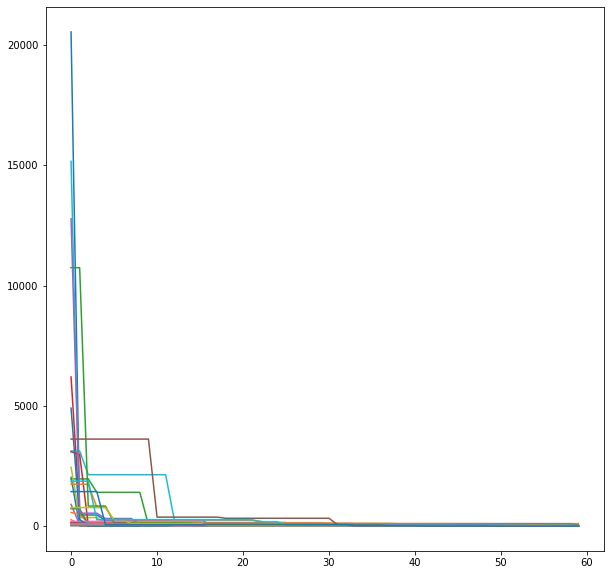

10d HCEF
best in 31 runs: 12.377391940273027
worst in 31 runs: 225908.5969449938
mean: 19672.729530145392
std: 42330.23999503506
best solution: [-3.000745102492735, 0.5558861272189488, -0.15916715501078804, -0.011649849777912414, 0.042133524803878324, -0.013383851882184444, 0.0016731290607999618, -0.0015538377222258644, 1.1657092965950832e-05, 0.00017101725665504255]
average runtime: 0.41532928712906375
highest runtime: 0.5230350494384766
lowest runtime: 0.3660008907318115


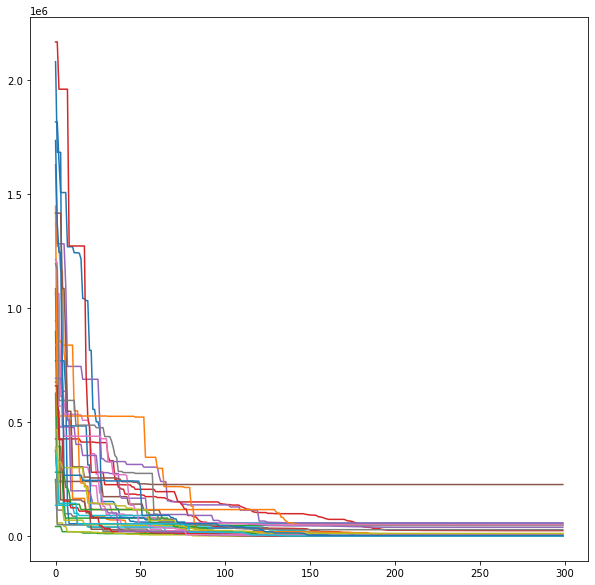

20d HCEF
best in 31 runs: 1941.58777540824
worst in 31 runs: 1756431.7609682519
mean: 265442.30952820036
std: 410526.345064709
best solution: [3.5926984175903645, -10.0, 10.0, -0.20785419505690794, 0.930181050912581, -1.6046288650030036, -1.4605139546117212, -1.6601546429299865, -0.29612632659077603, 0.5722094172973295, 0.16558300811430804, 0.0821509102578744, -0.035563617602359175, 0.10867911967607152, -0.01346328211543692, 0.009033608083538458, 0.00540984555386306, 0.013344888790508581, -0.008593219603935753, -0.0002855568621978341]
average runtime: 1.4864804360174364
highest runtime: 1.8059978485107422
lowest runtime: 1.3930065631866455


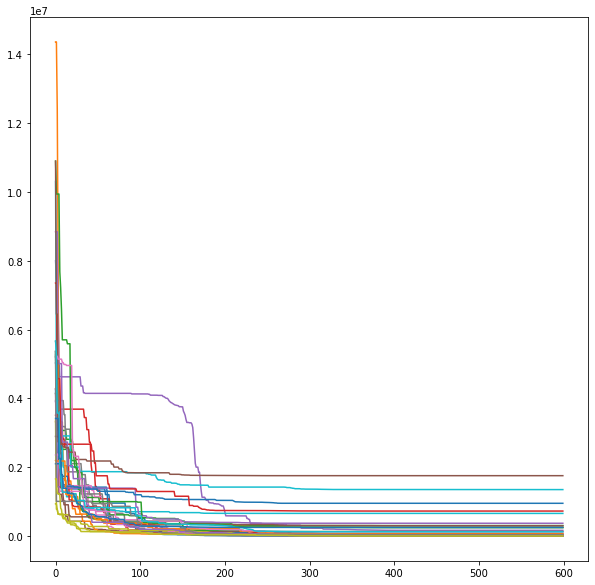

In [6]:
## HCEF
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d HCEF")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"HCEF",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d HCEF")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"HCEF",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d HCEF")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"HCEF",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()


(60, 100, 2)


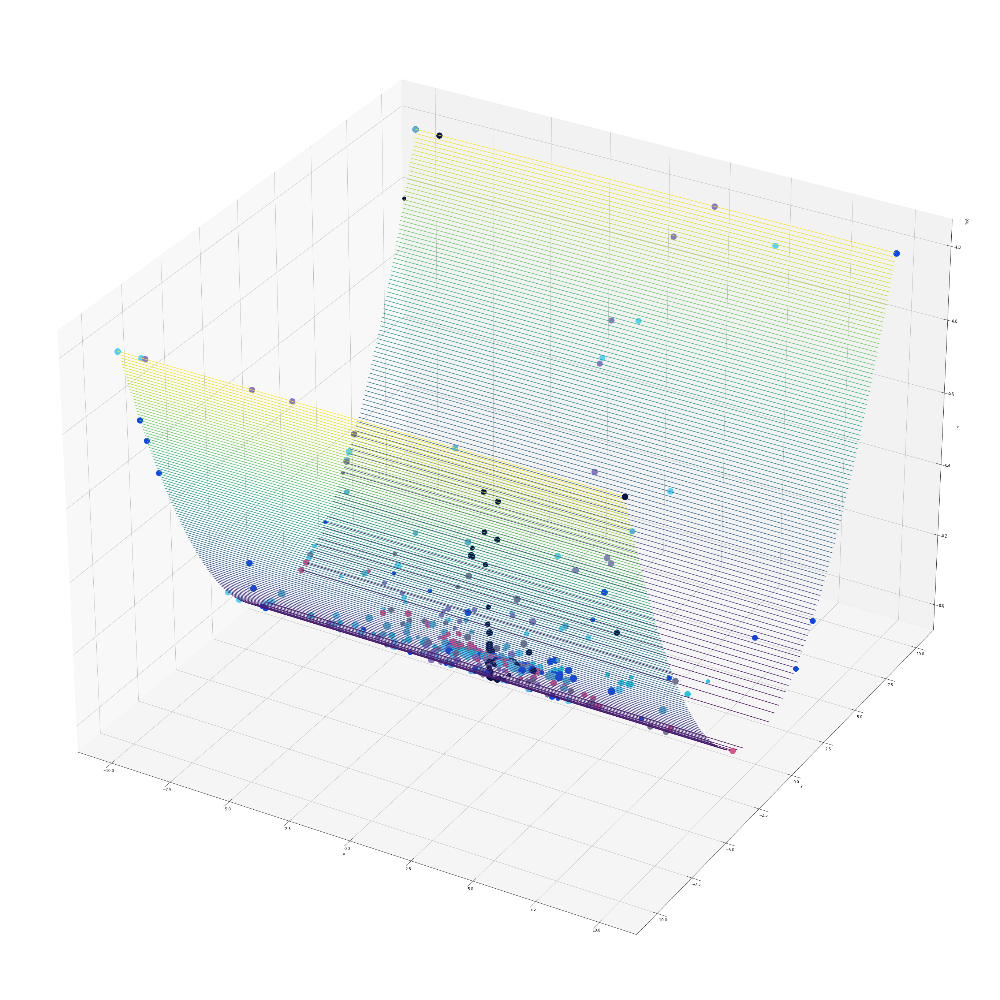

In [7]:
plot_generation_func(p_record_31[0], f_HCEF)

2d f_BC
best in 31 runs: 4.798299105860243e-06
worst in 31 runs: 100.01752062580539
mean: 9.655340665773528
std: 24.880784147361023
best solution: [-0.000771812133779505, -2.0500256427691266e-06]
average runtime: 0.03674207964251118
highest runtime: 0.47299623489379883
lowest runtime: 0.019999980926513672


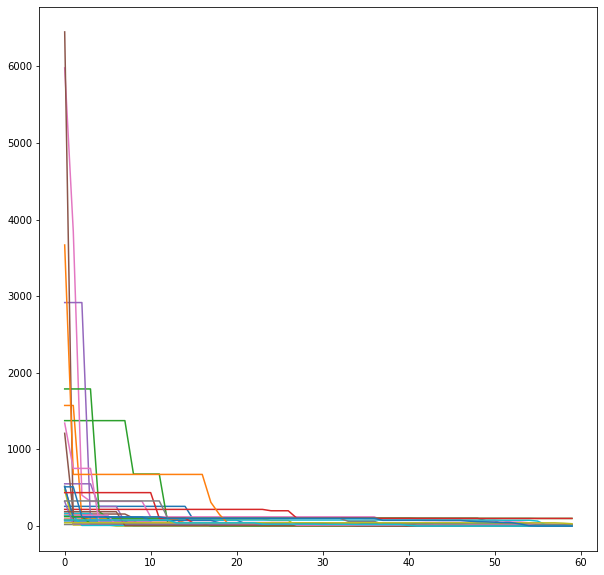

10d f_BC
best in 31 runs: 0.33998277716857234
worst in 31 runs: 492.2281297017721
mean: 73.0624659610635
std: 117.03010647461659
best solution: [-0.3437053701466417, 6.885249266697994e-05, 0.0002893389821924424, 1.248133670119708e-05, -0.00016398547757421792, 0.00018839616290958414, -0.00020917455713607207, -2.3751112448357443e-05, -0.00015689621037041454, 4.378375262544271e-05]
average runtime: 0.36313675295922065
highest runtime: 0.8510341644287109
lowest runtime: 0.32924962043762207


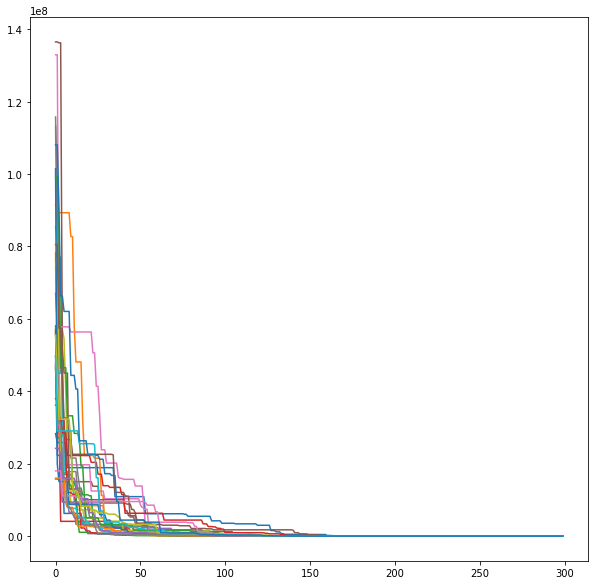

20d f_BC
best in 31 runs: 5264.15298886696
worst in 31 runs: 1797153.1272101076
mean: 218145.17328722053
std: 448310.37595571746
best solution: [-2.3870182981663985, 0.002366878432756959, 0.006789944845337844, 0.013836718847428714, 0.020737125304715862, -0.008918250187076806, -0.01491032638699025, 0.018107115033706437, 0.027490202234728357, 0.01755154545623457, -0.001668237509190065, -0.013938008961620112, 0.029178262521623463, -0.025751118122733552, -0.013638328643849984, 0.009626091519871822, -0.006449777546527288, -0.02430195311445837, -0.00845621221976148, 0.014066911076215235]
average runtime: 1.311600669737785
highest runtime: 1.9886302947998047
lowest runtime: 1.2322545051574707


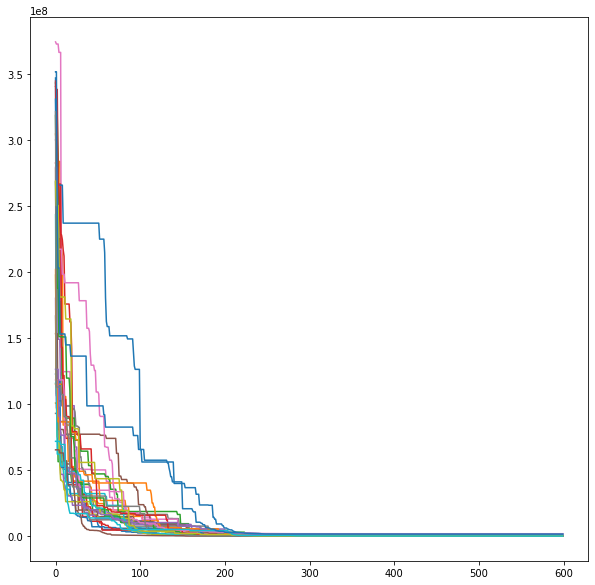

(60, 100, 2)


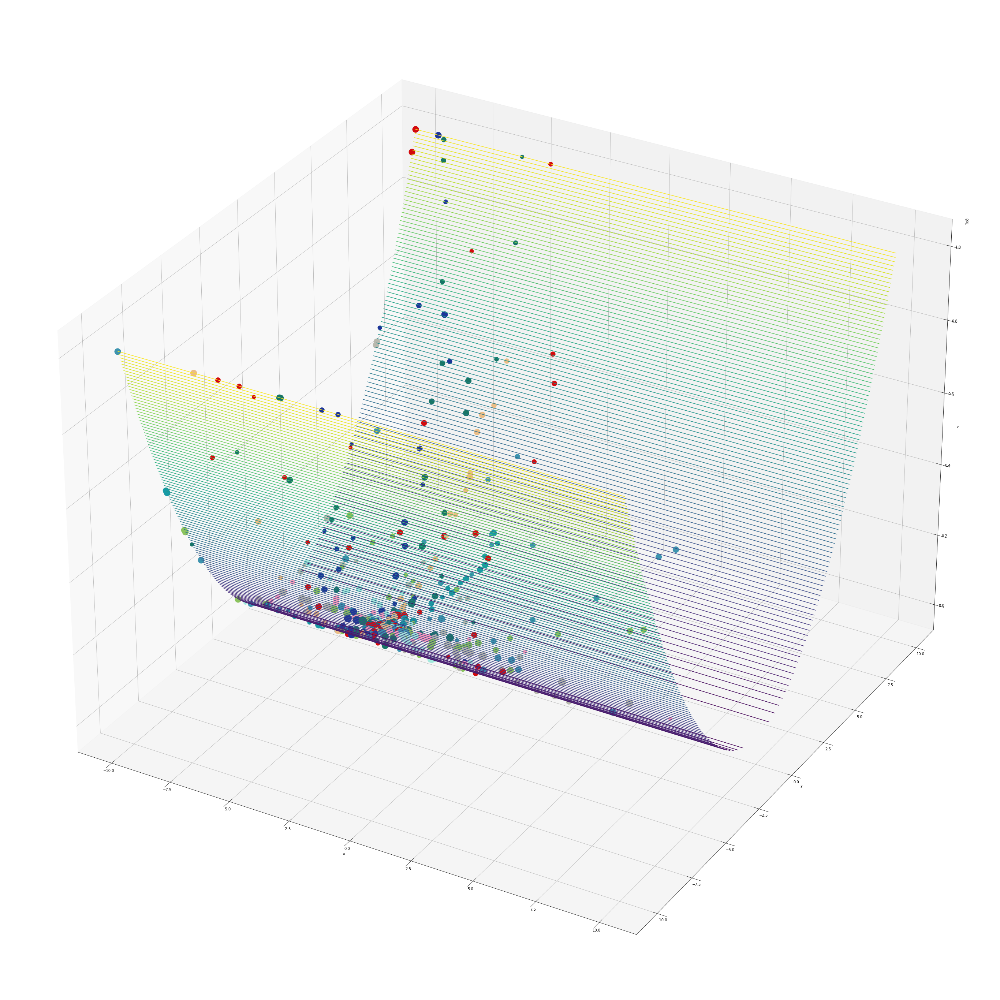

In [8]:
## f_BC
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_BC")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"BC",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_BC")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"BC",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_BC")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"BC",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_BC)

2d f_Discus
best in 31 runs: 1.486726844290999e-05
worst in 31 runs: 100.00002043198377
mean: 8.808892085398817
std: 24.912988356662602
best solution: [-3.66816966466065e-06, 0.0011881918002466449]
average runtime: 0.02200117418842931
highest runtime: 0.029000520706176758
lowest runtime: 0.019997119903564453


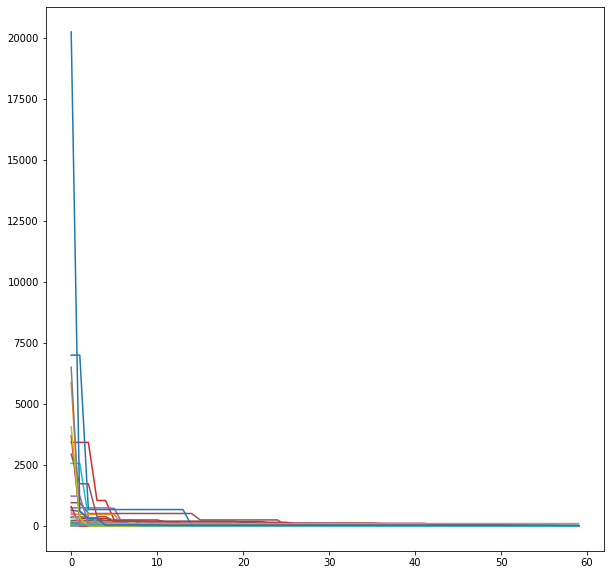

10d f_Discus
best in 31 runs: 0.21259718341539116
worst in 31 runs: 300.03600427324693
mean: 53.90393150108377
std: 76.64541743381997
best solution: [3.399081579236802e-06, -0.1504640852268001, -0.16311023499775132, -0.22477951057346823, 0.03633521336585654, 0.17973007013040485, 0.1234091785430801, -0.048558926467548766, 0.050606516104042654, -0.24298858323392813]
average runtime: 0.36667753804114556
highest runtime: 0.9380145072937012
lowest runtime: 0.31799936294555664


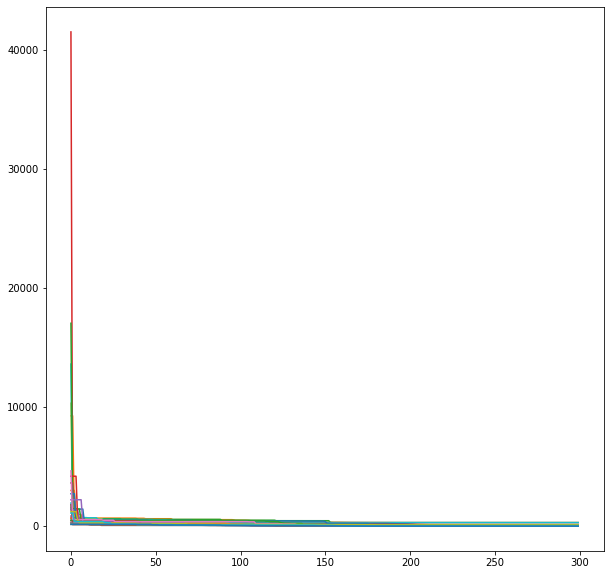

20d f_Discus
best in 31 runs: 2.45246931549479
worst in 31 runs: 1098.3773304914976
mean: 187.67026923733752
std: 220.34499876286847
best solution: [-2.8990657056806254e-05, 0.05681171848311727, -0.1806415226613032, -0.09056212489996612, 0.08495947360534929, -0.7682800356187336, -0.01777937874179207, -0.10167557540599015, 0.3633764244402694, -0.2643417349704616, -0.15230294478111522, 0.26063027486907436, 0.34906730652659784, 0.10217395806422615, 0.19142329099002944, 1.01166693568592, -0.20724992408006918, -0.29471654772179284, 0.12353545048139582, 0.4110073215162516]
average runtime: 1.3187957117634435
highest runtime: 2.01403546333313
lowest runtime: 1.2019658088684082


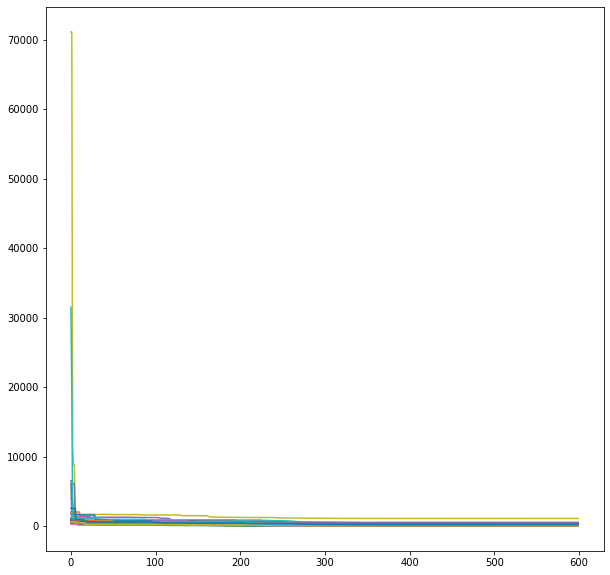

(60, 100, 2)


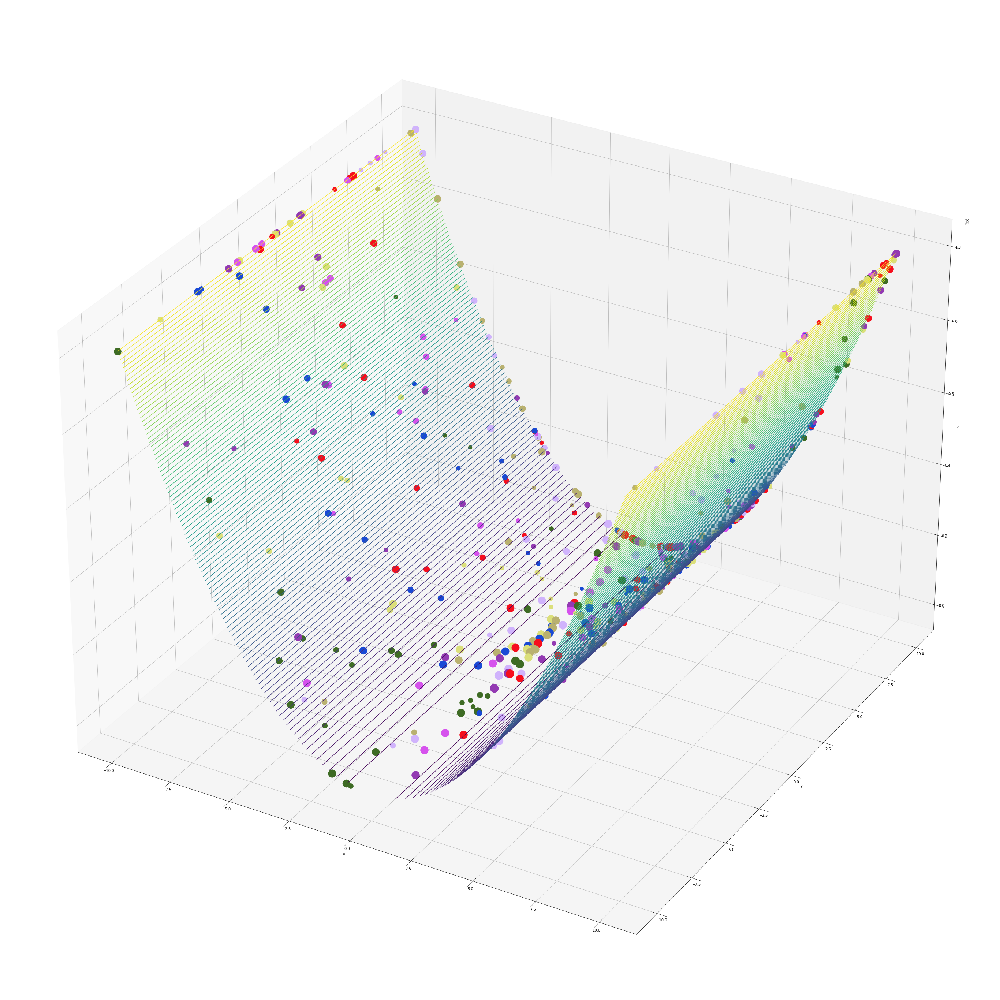

In [9]:
## f_Discus
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Discus")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Discus",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Discus")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Discus",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Discus")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Discus",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Discus)

2d f_Rosenbrock
best in 31 runs: 1.6584856302107905e-09
worst in 31 runs: 0.011189057146364161
mean: 0.0004395966330296936
std: 0.0019793506571216947
best solution: [1.0000389878541274, 1.0000791538032552]
average runtime: 0.024709616937944965
highest runtime: 0.028032541275024414
lowest runtime: 0.021999359130859375


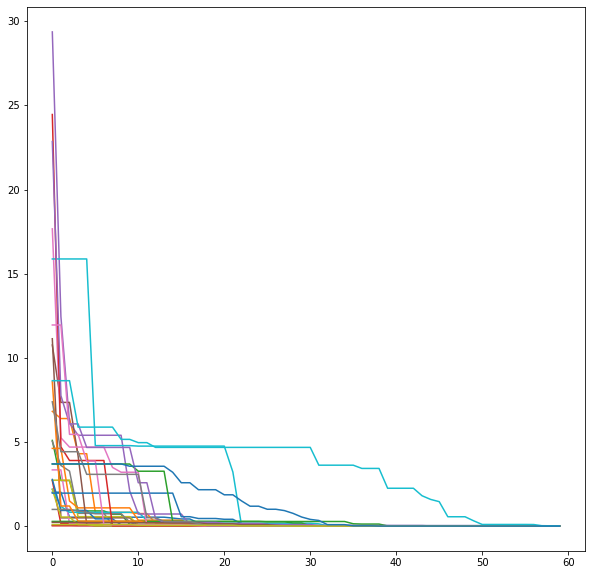

10d f_Rosenbrock
best in 31 runs: 0.21425535033329007
worst in 31 runs: 999.6973364283831
mean: 162.60761042206408
std: 288.3630136775115
best solution: [1.001265198238623, 1.0012025457614104, 1.0038939108300964, 1.0105837449819763, 1.0220648331466142, 1.0444531077598331, 1.088540217874408, 1.185438081499906, 1.4074562767699461, 1.984284433774579]
average runtime: 0.4489725635897729
highest runtime: 0.991044282913208
lowest runtime: 0.4039630889892578


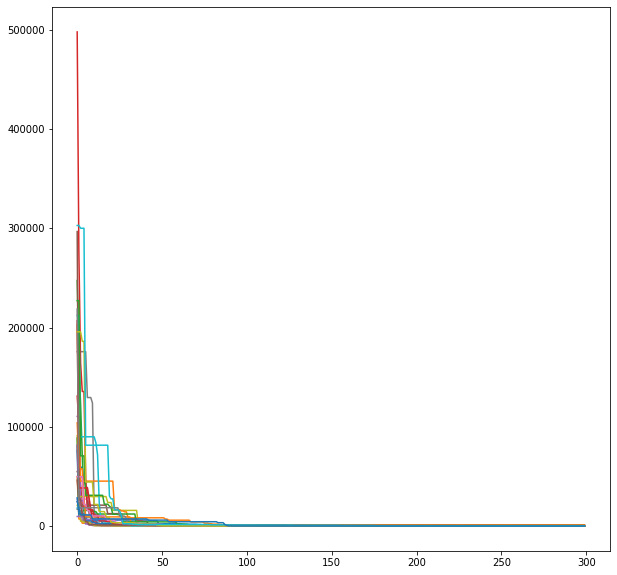

20d f_Rosenbrock
best in 31 runs: 19.60124421772672
worst in 31 runs: 649.3662781570436
mean: 121.48588524091733
std: 143.81603143520556
best solution: [0.17348107331958726, 0.0226509660795766, -0.01773587595403453, 0.009084783968108396, -0.01633848178117356, 0.0010974107946198572, -0.03724537398713328, 0.0034266838709060645, 0.029493665272870635, 0.00612804603071195, 0.0292643333592675, -0.009241041601158281, 0.028756952223077118, 0.03588275533312479, 0.045093942178870326, 0.004186016207741137, 0.013885355041292149, 0.07134753142546091, 0.034317593957071235, -0.005705681366200785]
average runtime: 1.6549892579355547
highest runtime: 2.3229994773864746
lowest runtime: 1.5649969577789307


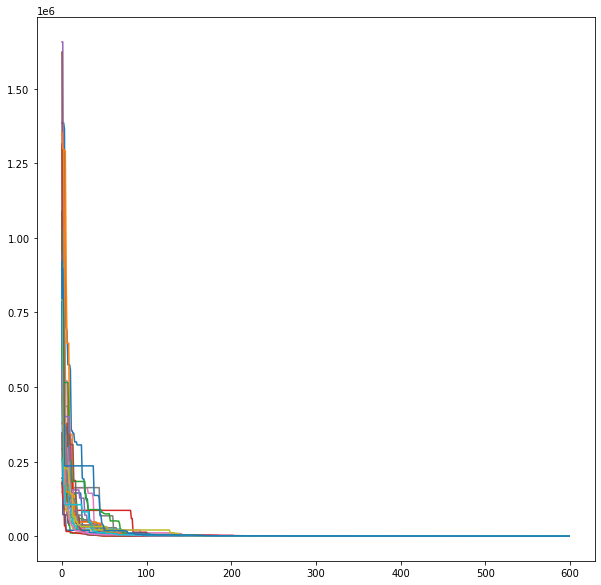

(60, 100, 2)


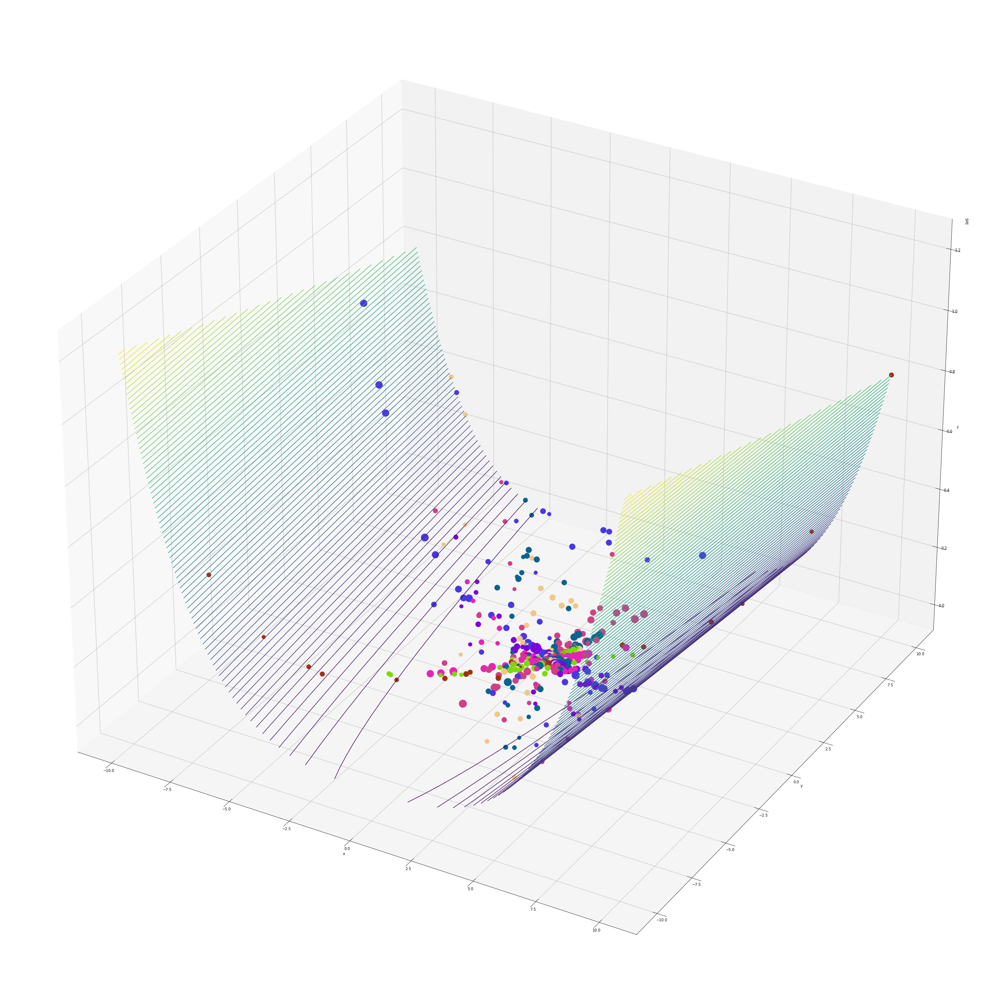

In [10]:
## f_Rosenbrock
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Rosenbrock")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Rosenbrock",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Rosenbrock")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Rosenbrock",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Rosenbrock")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Rosenbrock",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Rosenbrock)

2d f_Ackley
best in 31 runs: 1.9144693557127113e-05
worst in 31 runs: 0.027825448969249766
mean: 0.003101704842738303
std: 0.006257929199531333
best solution: [-3.883483520116344e-06, 5.543250768401276e-06]
average runtime: 0.058226300824073055
highest runtime: 0.06796741485595703
lowest runtime: 0.05599665641784668


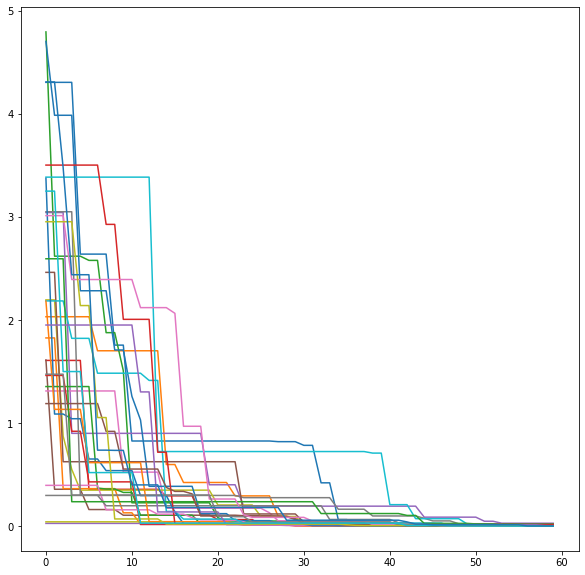

10d f_Ackley
best in 31 runs: 0.0001328413836678699
worst in 31 runs: 2.5799835949156145
mean: 0.7628053078037105
std: 0.9056608375740521
best solution: [-4.5288154911002656e-05, 1.4336759190198883e-06, 1.6137651430199647e-05, 1.6175020146686555e-05, 5.139928336086397e-05, 5.1262083722089243e-05, 3.245047636612967e-05, -2.2376367523989788e-05, -9.360534098999948e-06, 3.9158116197054494e-05]
average runtime: 0.7295536687297206
highest runtime: 1.230034351348877
lowest runtime: 0.6860003471374512


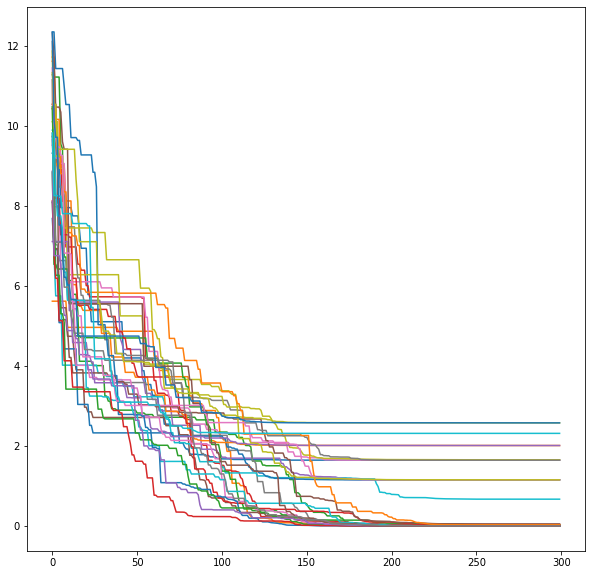

20d f_Ackley
best in 31 runs: 0.16948791224541937
worst in 31 runs: 3.357100748292478
mean: 1.6685202569313047
std: 0.7782090881417256
best solution: [0.00982177032574648, 0.008010461453855627, 0.02806732495457774, 0.00848115318254421, 0.06991881525081865, 0.009861625583078647, 0.028150856942724147, -0.01456755529005183, 0.04409337898917353, -0.019580062462172046, 0.035261212758730245, 0.008877877492367665, 0.07104904146939207, -0.014209801800659902, -0.011611464600257377, 0.04092209827653924, 0.0021132914615735452, 0.005501142029283733, 0.00495458296135312, 0.025327831730751208]
average runtime: 2.443782821778328
highest runtime: 3.1905298233032227
lowest runtime: 2.357065200805664


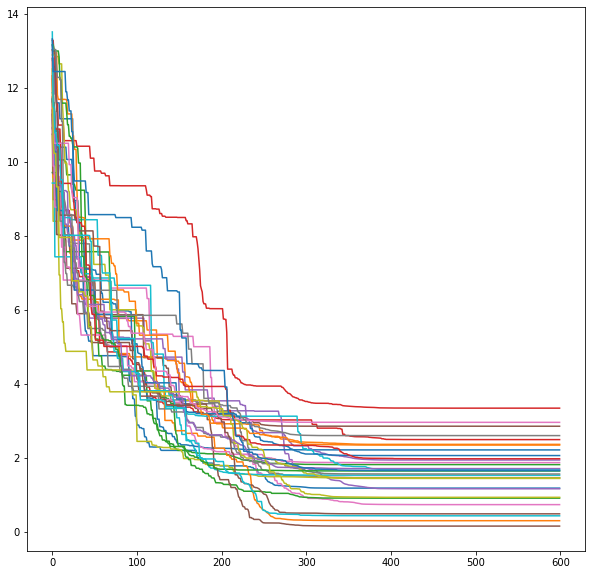

(60, 100, 2)


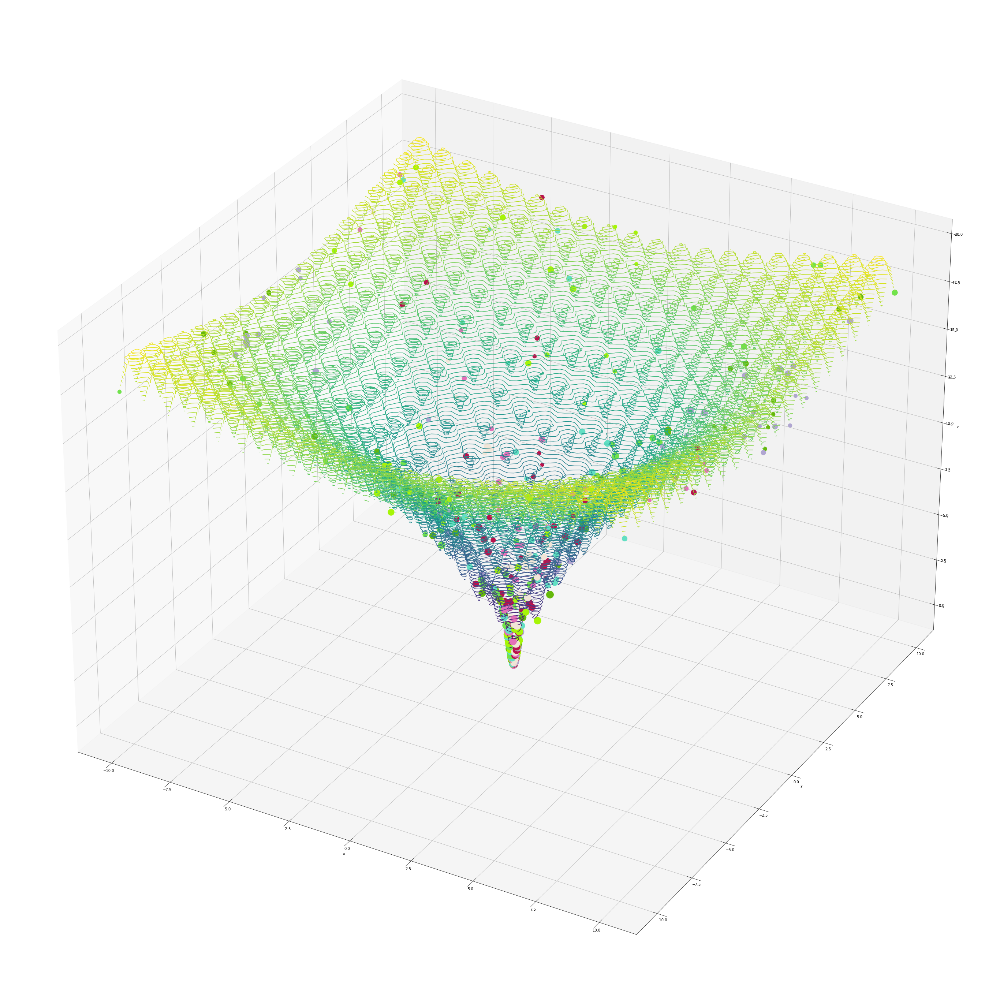

In [11]:
## f_Ackley
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Ackley")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Ackley",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Ackley")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Ackley",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Ackley")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Ackley",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Ackley)

2d f_Weierstrass
best in 31 runs: 0.0
worst in 31 runs: 0.0
mean: 0.0
std: 0.0
best solution: [10, 10]
average runtime: 0.49581469258954447
highest runtime: 0.5129644870758057
lowest runtime: 0.49199914932250977


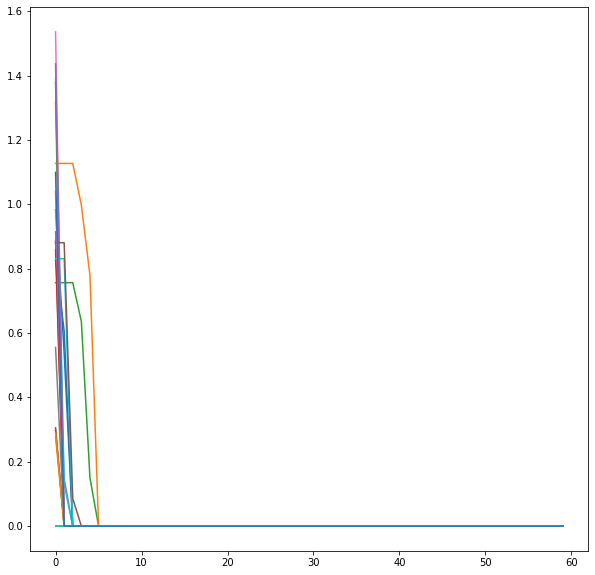

10d f_Weierstrass
best in 31 runs: 0.0
worst in 31 runs: 0.0
mean: 0.0
std: 0.0
best solution: [-10, 10, -10, 10, 10, 10, -10, 10, -10, 10]
average runtime: 8.855633820256879
highest runtime: 9.379436254501343
lowest runtime: 8.754199743270874


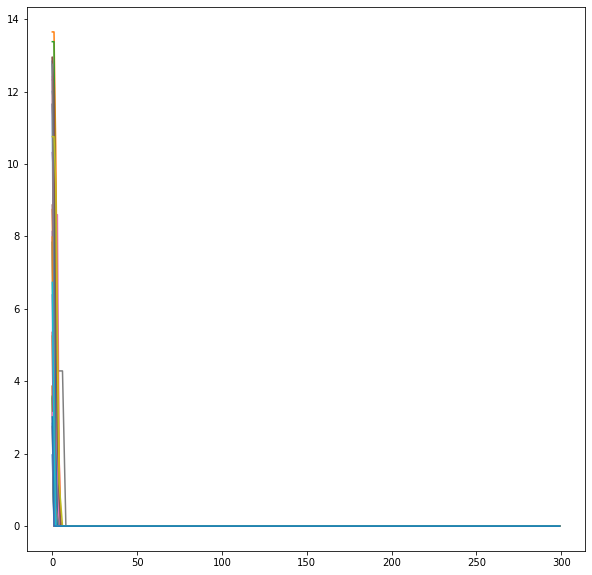

20d f_Weierstrass
best in 31 runs: 0.0
worst in 31 runs: 0.0
mean: 0.0
std: 0.0
best solution: [10, 10, 10, 10, 10, 10, 10, 10, -10, -10, 10, -10, 10, 10, -10, -10, -10, 10, 10, 10]
average runtime: 33.371638574907855
highest runtime: 36.45854902267456
lowest runtime: 33.01893615722656


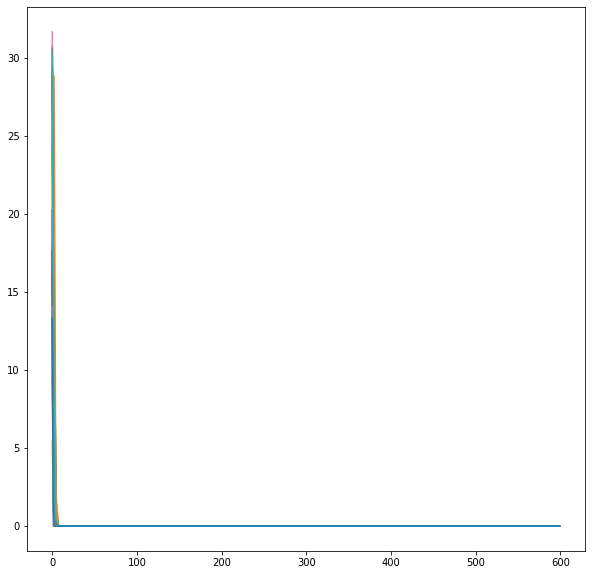

(60, 100, 2)


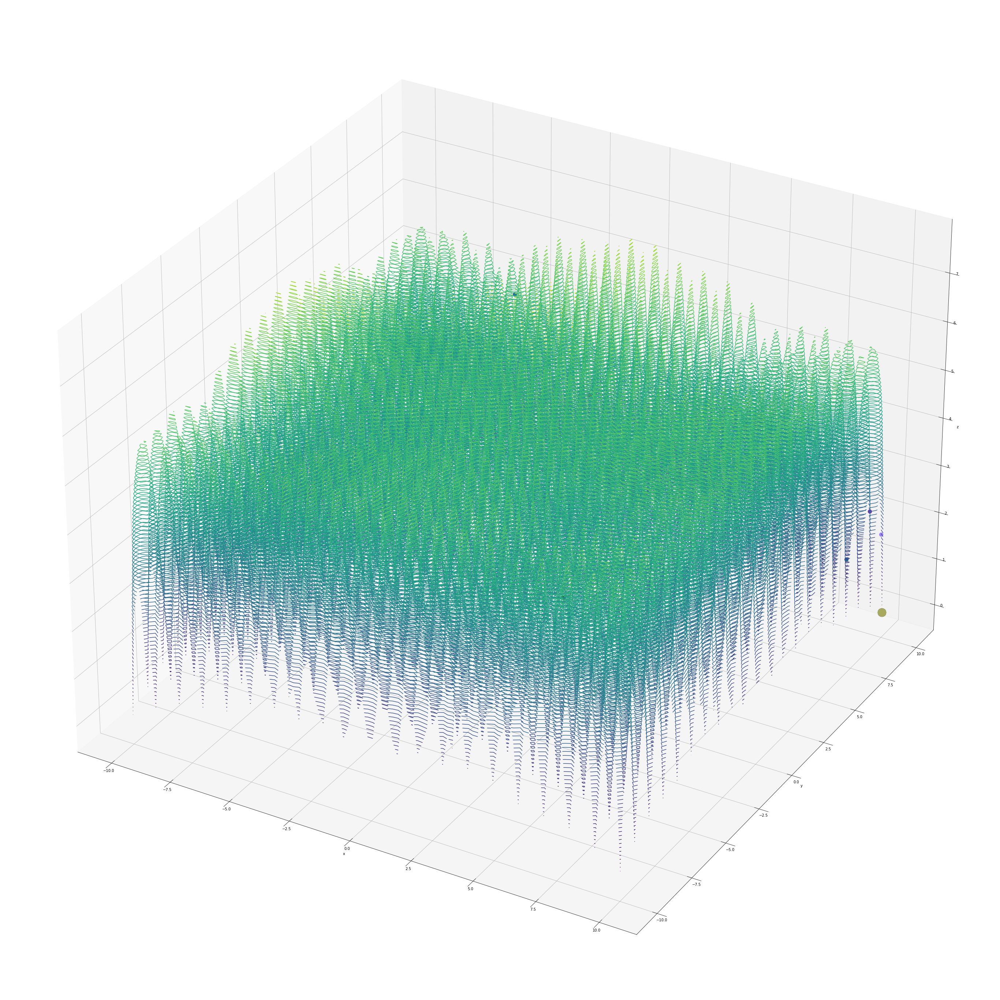

In [12]:
## f_Weierstrass
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Weierstrass")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Weierstrass",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Weierstrass")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Weierstrass",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Weierstrass")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Weierstrass",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Weierstrass)

2d f_Griewank
best in 31 runs: 4.6194299052615406e-08
worst in 31 runs: 0.01971964788228253
mean: 0.003975438236726751
std: 0.004745028011157179
best solution: [0.0003034828620715043, 2.192988005315119e-05]
average runtime: 0.05438707720848822
highest runtime: 0.06400012969970703
lowest runtime: 0.05196785926818848


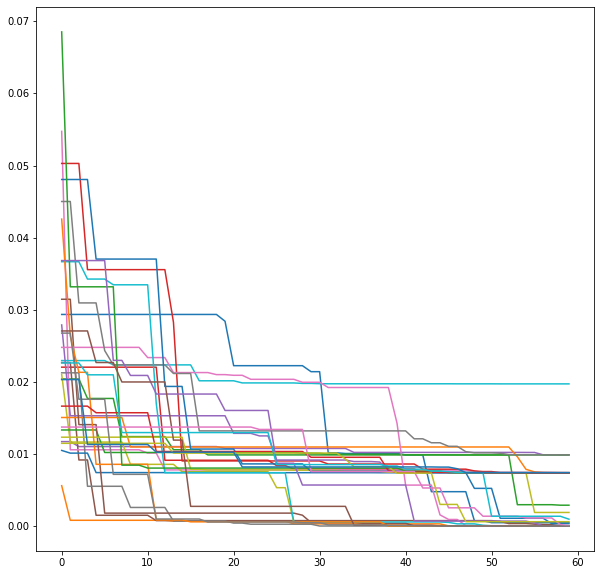

10d f_Griewank
best in 31 runs: 0.039387600929375544
worst in 31 runs: 0.32038323171469907
mean: 0.14348804369349075
std: 0.07433299552664412
best solution: [3.07651439345257e-05, 4.4382425088932145, -5.433500398372201, -0.0006580597013407232, -7.007235466567623, 7.673497661460653, -8.39500475952471e-05, -0.00010966168747422534, 0.0008306268437481552, -0.00043545827411130603]
average runtime: 1.0141160795765538
highest runtime: 1.5279982089996338
lowest runtime: 0.9520277976989746


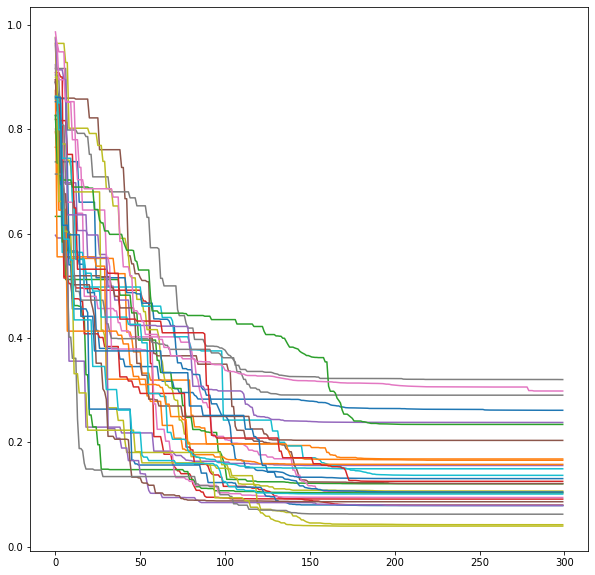

20d f_Griewank
best in 31 runs: 0.005557751516157228
worst in 31 runs: 0.24066040988547732
mean: 0.06241039710561855
std: 0.056371296263446675
best solution: [0.0008225536586141309, 0.003292665972505769, 0.0034028260651591444, 0.03544462149137247, -0.0883056997688018, 0.021837595712084035, -0.032108478379226424, 0.0003989263722971828, 0.1221121404541942, 0.04929132624341759, -0.039256939326488396, -0.123694102143279, 0.07427959686152232, 0.20090612330378518, 0.0316256256225607, 0.09554177620281377, -0.07128943811988728, 0.008049275775882837, 0.1573734732533727, 0.044898698301477476]
average runtime: 3.736448480236915
highest runtime: 4.365034580230713
lowest runtime: 3.653968334197998


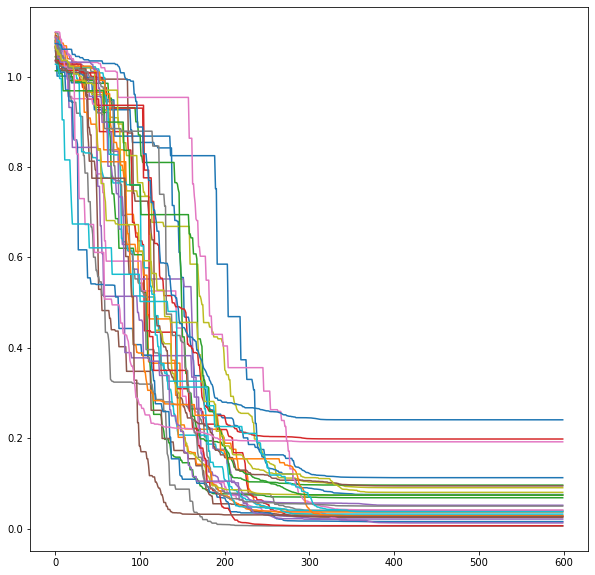

(60, 100, 2)


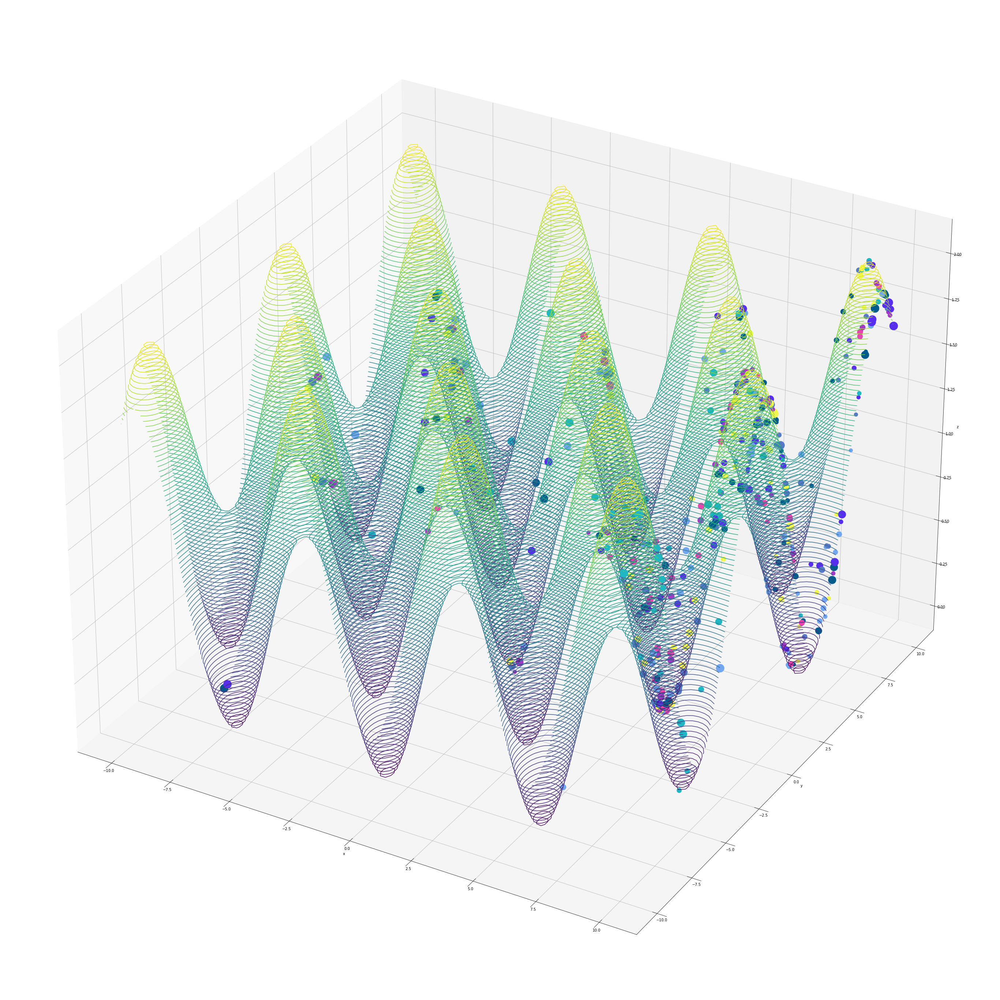

In [13]:
## f_Griewank
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Griewank")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Griewank",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Griewank")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Griewank",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Griewank")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Griewank",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Griewank)

2d f_Rastrigin
best in 31 runs: 6.132194663166501e-08
worst in 31 runs: 0.9949707074310776
mean: 0.04645808484241406
std: 0.17977739950830982
best solution: [-6.816661360919626e-06, -1.6205796585620855e-05]
average runtime: 0.041856719601538875
highest runtime: 0.05199909210205078
lowest runtime: 0.038999080657958984


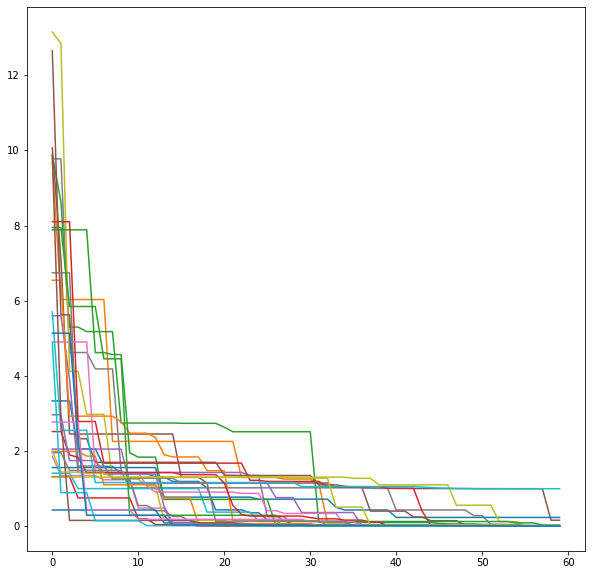

10d f_Rastrigin
best in 31 runs: 2.986968790608474
worst in 31 runs: 36.813876842670254
mean: 16.04636498254881
std: 8.6565353237283
best solution: [-0.0013518103958280808, 0.0012000979667204604, -0.0012890367147382047, 0.00045846171125226294, 0.9955491710002916, -0.0019591164602879947, -0.9947027698236544, 0.9957872454565456, -0.000651890776629359, -0.00020029126538647398]
average runtime: 0.7581168605435279
highest runtime: 1.2929675579071045
lowest runtime: 0.7157509326934814


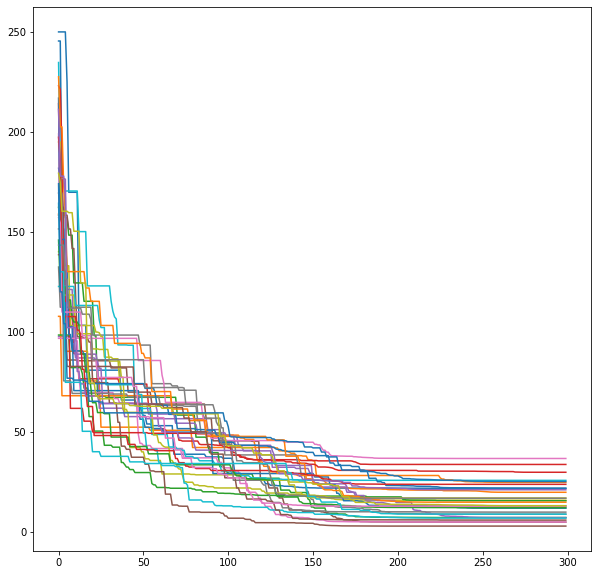

20d f_Rastrigin
best in 31 runs: 16.708067797745336
worst in 31 runs: 194.35994744253577
mean: 75.17318871488185
std: 37.57496016305793
best solution: [-0.9980462342020054, -0.03501912419150637, 0.0104385011534475, -0.0073025922437552, -0.017933756491589587, -1.0146696539638647, 1.9678108789935482, -0.02571868283590936, 0.007743527854903699, -1.0137329944596296, 1.000831025017916, -0.02980298439539025, 0.005226973243076775, 0.028795287324982405, -1.0009546581818367, 1.9832058897985858, 0.03577485894170295, -0.9638128254191142, 0.9963160495390232, 0.03520467762392708]
average runtime: 2.9244194492217033
highest runtime: 3.5950000286102295
lowest runtime: 2.8239998817443848


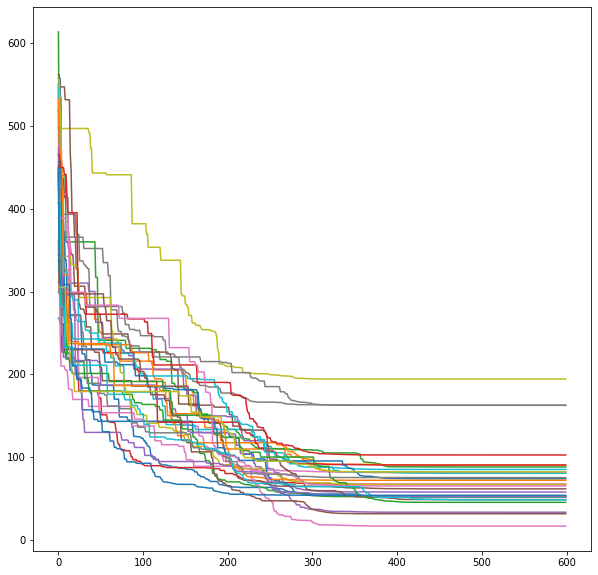

(60, 100, 2)


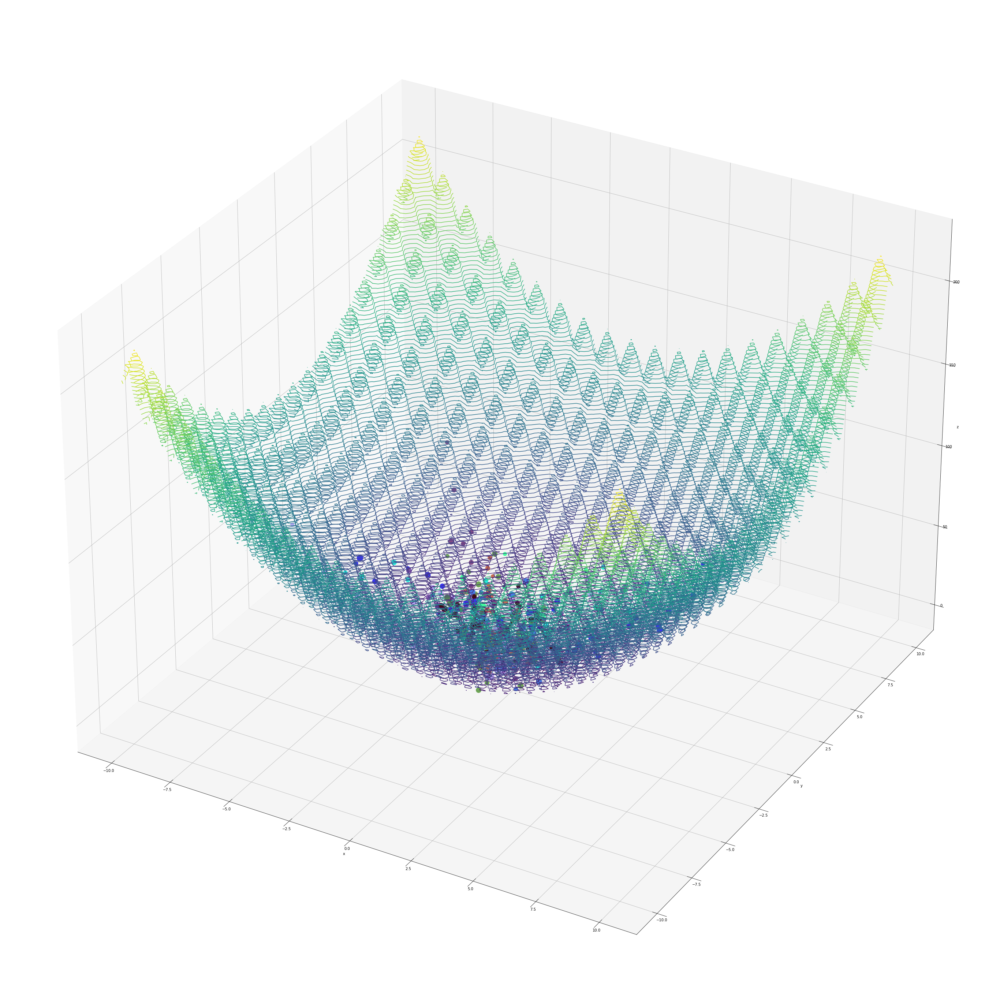

In [14]:
## f_Rastrigin
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Rastrigin")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Rastrigin",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Rastrigin")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Rastrigin",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Rastrigin")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Rastrigin",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Rastrigin)